In [11]:
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px
import seaborn as sns

df = pd.read_csv('Covid Data.csv')

In [12]:
disease = ["PNEUMONIA", "DIABETES","COPD","ASTHMA","INMSUPR","HIPERTENSION","OTHER_DISEASE","CARDIOVASCULAR","OBESITY","RENAL_CHRONIC"]
df_covid = df[df["CLASIFFICATION_FINAL"].isin([1, 2, 3])].copy()

In [13]:
df_covid["DIED"] = df_covid["DATE_DIED"].apply(lambda x: "YES" if x != "9999-99-99" else "NO")

In [14]:
df_subset = df_covid[disease + ["DIED"]].copy()
df_subset = df_subset.apply(lambda col: col.map(lambda x: None if x in [2,97,98,99] else x))
df_subset = df_subset.melt(id_vars=["DIED"],value_vars=disease,var_name="DISEASE",value_name="HAS_DISEASE")
df_subset = df_subset[df_subset["HAS_DISEASE"] == 1]

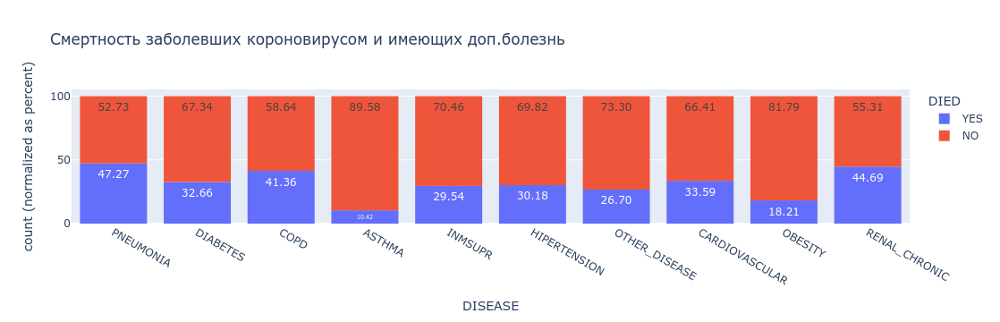

In [15]:
px.histogram(df_subset,x='DISEASE',color='DIED',barnorm='percent',text_auto='.2f',title='Смертность заболевших короновирусом и имеющих доп.болезнь',)

In [16]:
df_ages_death = df_covid[['AGE','DIED']][df_covid['DIED'] == 'YES']

Text(0.5, 1.0, 'Смертность в зависимости от возраста')

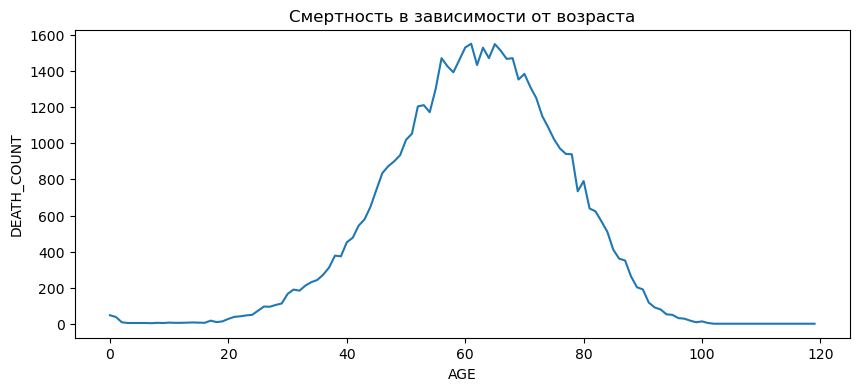

In [17]:
df_death_counts = df_ages_death.groupby('AGE').size().reset_index(name='DEATH_COUNT')
plt.figure(figsize=(10,4))
sns.lineplot(data=df_death_counts,x='AGE',y='DEATH_COUNT')
plt.title('Смертность в зависимости от возраста')
# px.line(df_death_counts,'AGE','DEATH_COUNT',title='Смертность в зависимости от возраста')
# если px то гит не дает из-за ограничения файла 25 мб

In [18]:
df_covid['PATIENT_TYPE'] = df_covid['PATIENT_TYPE'].map({1: 'Home', 2: 'Hospital'})

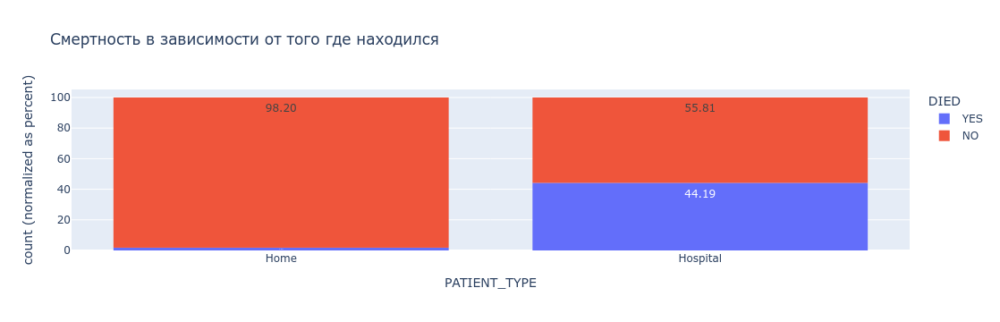

In [19]:
px.histogram(df_covid,x='PATIENT_TYPE',color='DIED',barnorm='percent',text_auto='.2f',title='Смертность в зависимости от того где находился')

Такая статистика выглядит странной. Возможной причиной вижу отсутсвие информации полной по тем кто умер находясь дома, либо проблема в сборе данных.

Text(0.5, 1.0, 'Корреляция между заболеваниями')

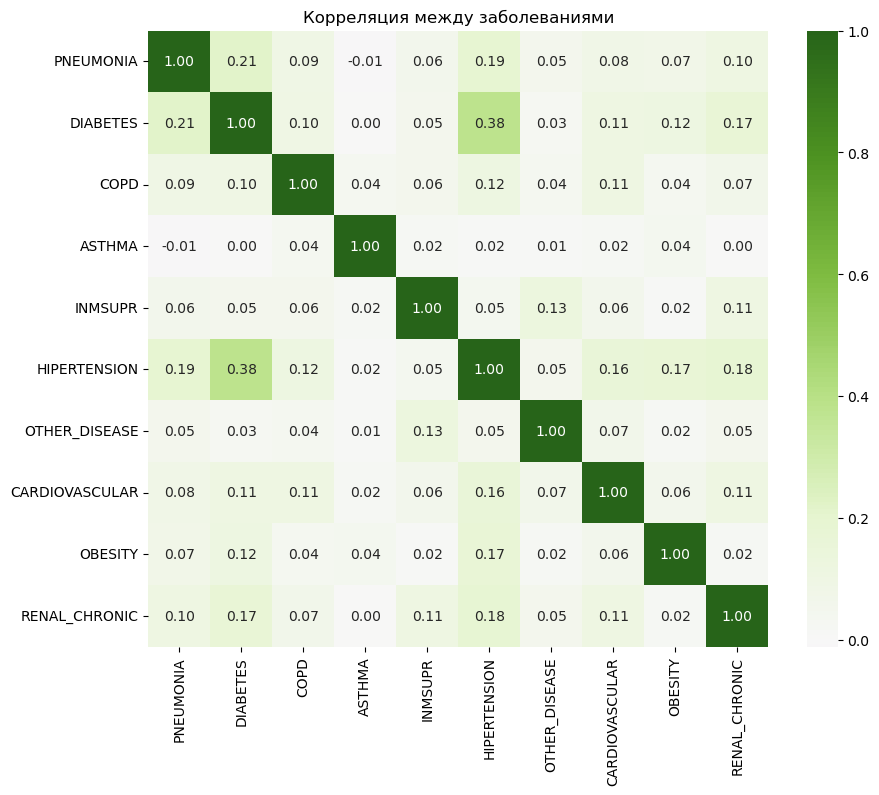

In [20]:
disease_df_for_corr = df[disease].apply(lambda col: col.map(lambda x: 0 if x in [2,97,98,99] else x))
corr = disease_df_for_corr.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='PiYG', center=0, fmt='.2f')
plt.title('Корреляция между заболеваниями')